In [1]:
import os
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from mpl_toolkits.mplot3d import Axes3D

import plotly.graph_objs as go
import plotly.express as px

from IPython.display import display, HTML

from sklearn import decomposition
from sklearn import cluster
from sklearn import mixture
from sklearn import model_selection
from sklearn import metrics
from sklearn import preprocessing
from sklearn import neighbors
from sklearn import manifold

from zipfile import ZipFile

import warnings
warnings.filterwarnings("ignore")

plt.rcParams["patch.force_edgecolor"] = True   # turn on the edges on bar plots globally

Let's read data from `zip-archive` at folder `'data'` and create a dictionary structure to keep descriptors and results of survey.

In [101]:
data = {'descriptor_name': {0: 'efficientnet-b7', 1: 'osnet', 2: 'vdc_color', 3: 'vdc_type'}, 
        'descriptor': {},
        }

with ZipFile('data/archive.zip') as myzip:
    for i in data['descriptor_name']:
        data['descriptor'][i] = pd.read_pickle(myzip.open('IntelliVision_case/descriptors/' + data['descriptor_name'][i] + '.pickle'))
    images_paths = pd.read_csv(myzip.open('IntelliVision_case/images_paths.csv'))

In [102]:
n_models = len(data['descriptor_name'])  # number of models

Initially we have 416 314 car images and 4 descriptors for them. Descriptor `efficientnet-b7` has the most number of features - 2 560. 

As we have the memory limitation of `15.4 Gb` and plan to work with models with the memory complexity of the order *$O(N^2)$*  we should diminish the number of samples for exploratory stage. Let's take random 100 000 car images and corresponding descriptors data.

In [103]:
np.random.seed(seed=32)
new_index = np.array(images_paths.index)
np.random.shuffle(new_index)
new_index = new_index[:100000]
for i in data['descriptor_name']:
    data['descriptor'][i] = np.take(data['descriptor'][i], new_index, axis=0)
images_paths = images_paths.loc[new_index]

In [104]:
for i in data['descriptor']:
    print(f"{data['descriptor_name'][i]}.shape: {data['descriptor'][i].shape}")
print(f'Number of folders with cars images: {images_paths.shape[0]}')

efficientnet-b7.shape: (100000, 2560)
osnet.shape: (100000, 512)
vdc_color.shape: (100000, 128)
vdc_type.shape: (100000, 512)
Number of folders with cars images: 100000


Now we have 100 000 samples and 4 descriptors with 2 560, 512, 128 and 512 features correspondingly.

Clusterisation models work with distances between samples at the feature space, so we need to scale our data for comparatibility. Let's consider three the most common scalers.

In [105]:
data['scaled'] = {'MinMax': {}, 'Robust': {}, 'Standard': {}}

for i in data['descriptor']:
    data['scaled']['MinMax'][i] = preprocessing.MinMaxScaler().fit_transform(data['descriptor'][i])
    data['scaled']['Robust'][i] = preprocessing.RobustScaler().fit_transform(data['descriptor'][i])
    data['scaled']['Standard'][i] = preprocessing.StandardScaler().fit_transform(data['descriptor'][i])

The good practice to work with the high dimensional feature spaces is to apply dimensionality reduction methods. The `Principal Component Analysis PCA`, for example.

As criteria let's take the number of components that allows to keep 90% of initial information.

In [106]:
explained_variance_ratio_pca = []
data['pca'] = {'MinMax': {}, 'Robust': {}, 'Standard': {}}

for s in data['scaled']:
    for i in data['scaled'][s]:
        pca = decomposition.PCA(n_components=0.9).fit(data['scaled'][s][i])
        data['pca'][s][i] = pca.transform(data['scaled'][s][i])
        explained_variance_ratio_pca.append(pca.explained_variance_ratio_)

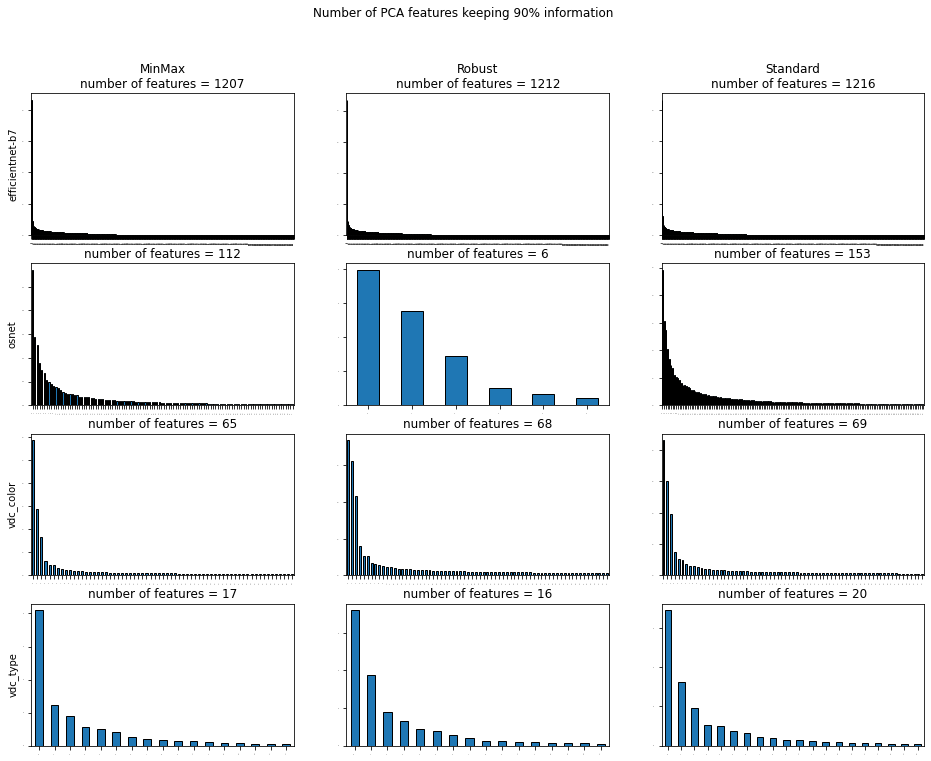

In [107]:
fig, ax = plt.subplots(nrows=n_models, ncols=3, figsize=(16, 12))
ind = 0

for s in data['pca']:
    for i in data['pca'][s]:
        if ind % n_models == 0:
            ax[0][ind // n_models].set_title(f'{s}\nnumber of features = {len(explained_variance_ratio_pca[ind])}')
        else:
            ax[ind % n_models][ind // n_models].set_title(f'number of features = {len(explained_variance_ratio_pca[ind])}')
        if ind // n_models == 0:
            ax[ind % n_models][0].set_ylabel(data['descriptor_name'][i])
        pd.DataFrame(explained_variance_ratio_pca[ind]).plot(kind='bar', ax=ax[ind % n_models][ind // n_models], legend=False, fontsize=1)
        ind += 1
plt.suptitle('Number of PCA features keeping 90% information')
plt.show();

As we can see all scalers give almost the same number of features for any particular descriptor. Except `RobustScaler` for `osnet` descriptor that diminishes the number of features to 6. Unfortunately, these features don't fit the purposes of our problem (it was shown out of boundaries of this notebook).

For simplicity further survey at this notebook is confined by data obtained with `StandardScaler`, but could be easily expanded on other scalers results.

The cause of this choice is shown below: distribution of `the main zero-component received after dimensionality reduction of data scaled by StandardScaler` looks more like a Gaussian distribution bell. We hope that it would increase the quality of our models results. 

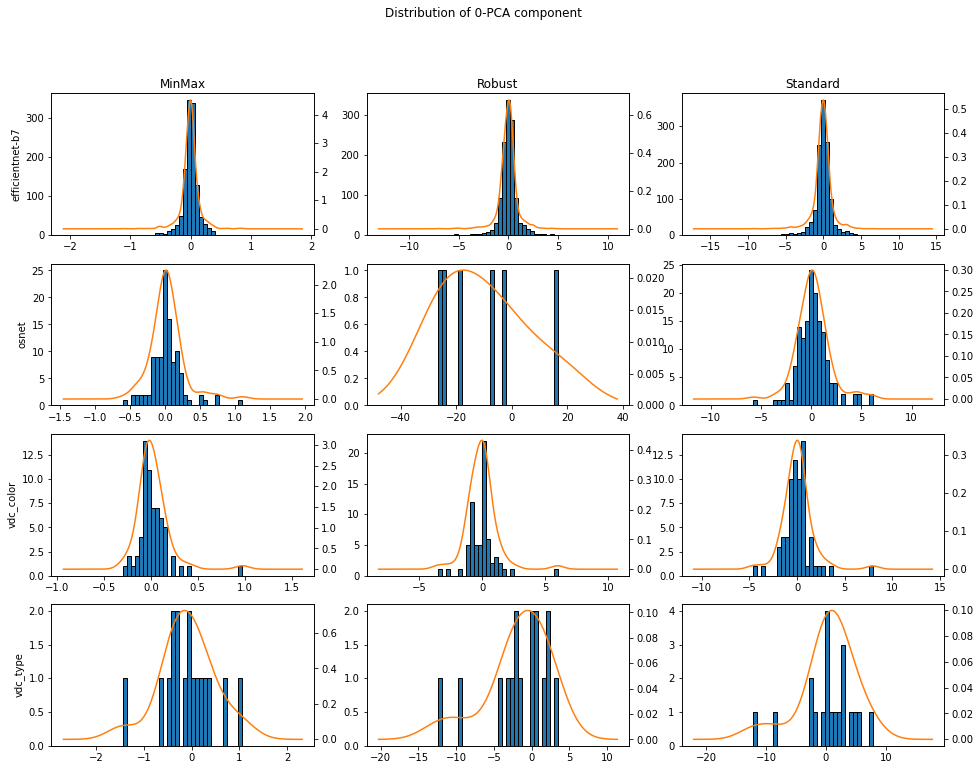

In [108]:
fig, ax = plt.subplots(nrows=n_models, ncols=3, figsize=(16, 12))
ind = 0

for s in data['pca']:
    for i in data['pca'][s]:
        pd.DataFrame(data['pca'][s][i][0]).plot(kind='hist', bins=30, ax=ax[ind % n_models][ind // n_models], legend=False, fontsize=10)
        pd.DataFrame(data['pca'][s][i][0]).plot(kind='density', ax=ax[ind % n_models][ind // n_models], legend=False, fontsize=10,
                                                secondary_y=True, mark_right=True)
        if ind % n_models == 0:
            ax[0][ind // n_models].set_title(s)
        if ind // n_models == 0:
            ax[ind % n_models][0].set_ylabel(data['descriptor_name'][i])
        else:
            ax[ind % n_models][ind // n_models].set_ylabel('')
        ind += 1
plt.suptitle('Distribution of 0-PCA component')
plt.show();

Some of clusterisation models need to get number of clusters as parameter. So we should train models for different number of clusters and compare quality of the results. There is no class labels at initial data, therefore inner metrics such as `Calinski Harabasz index CHI` and `Davies Bouldin index DBI` are used.

Function `scores_for_n_clust_choice` trains accepted model for all number of clusters given and returns dictionary with labels and quality indexes. The function is called for all descriptors prepared. As learning process takes time and some error could occur while training particular model (memory error for example), `try - except` block was included to not loose all results with stop by error. And some verbosity was added to follow the process propagation.

`KMEANS model` was trained first.

In [109]:
def scores_for_n_clust_choice(X, model, params, n_clust_range):
    '''
    Train model with params on data X for all number of clusters in n_clust_range.
    Avoid abrupt error stops at learning process.
    Return dictionary with labels, CHI and DBI for every number of clusters. 
    '''
    result = {}
    for cl in n_clust_range:
        result[cl] = {}
        try:
            X_pred = model(cl, **params).fit_predict(X)
        except Exception as e:
            print(e)
            result[cl]['cluster'] = None
            result[cl]['chi'] = None
            result[cl]['dbi'] = None            
        else:
            result[cl]['cluster'] = X_pred        
            result[cl]['chi'] = metrics.calinski_harabasz_score(X, X_pred)
            result[cl]['dbi'] = metrics.davies_bouldin_score(X, X_pred)
        print(f"descriptor  {data['descriptor_name'][i]}, n clusters = {cl}")
        print(f"    calinski_harabasz  {result[cl]['chi']}")
        print(f"    davies_bouldin     {result[cl]['dbi']}")
    return result
            

data['KMeans_base'] = {'MinMax': {}, 'Robust': {}, 'Standard': {}}
params = {'init': 'k-means++', 'n_init': 10, 'random_state': 32}
for i in data['pca']['Standard']:
    data['KMeans_base']['Standard'][i] = scores_for_n_clust_choice(
        data['pca']['Standard'][i], cluster.KMeans, params, n_clust_range=[_ for _ in range(2, 7)])

descriptor  efficientnet-b7, n clusters = 2
    calinski_harabasz  6458.442896641435
    davies_bouldin     3.08753436240807
descriptor  efficientnet-b7, n clusters = 3
    calinski_harabasz  4271.063924697245
    davies_bouldin     5.20397551656843
descriptor  efficientnet-b7, n clusters = 4
    calinski_harabasz  3170.9917098344517
    davies_bouldin     5.792720233347418
descriptor  efficientnet-b7, n clusters = 5
    calinski_harabasz  2599.284169234823
    davies_bouldin     5.873932141549237
descriptor  efficientnet-b7, n clusters = 6
    calinski_harabasz  2208.6061108026347
    davies_bouldin     6.06639936737439
descriptor  osnet, n clusters = 2
    calinski_harabasz  9573.248932945304
    davies_bouldin     3.0859202236692513
descriptor  osnet, n clusters = 3
    calinski_harabasz  7282.882479080184
    davies_bouldin     3.266085322926029
descriptor  osnet, n clusters = 4
    calinski_harabasz  6464.7877091803075
    davies_bouldin     3.116772250576284
descriptor  osnet, n 

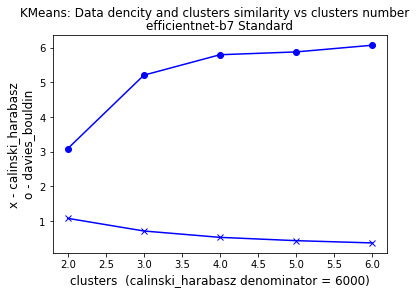

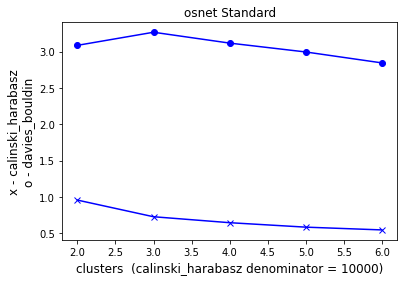

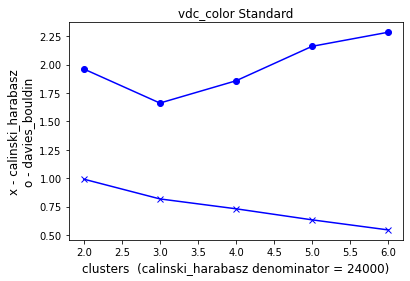

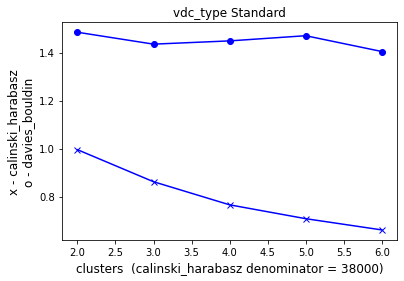

In [111]:
def plot_n_clust_choice(data, choice_model, scaling, descriptor):
    '''
    Plot CHI and DBI from model-scaler-descriptor dictionary vs number of clusters.
    Calinski_harabasz denominator is added as rounded maximum value to use the same scale for both indexes.
    '''
    dt = data[choice_model][scaling][descriptor]
    n_clust, chi, dbi = [], [], []
    for cl in dt:
        n_clust.append(cl)
        chi.append(dt[cl]['chi']) 
        dbi.append(dt[cl]['dbi'])
    plt.title(f"{data['descriptor_name'][descriptor]} {scaling}")
    chd = round(max(chi)/1000)*1000
    plt.xlabel(f"clusters  (calinski_harabasz denominator = {chd})", fontsize=12)
    plt.ylabel("x - calinski_harabasz\no - davies_bouldin", fontsize=12)
    plt.plot(n_clust, [i / chd for i in chi], 'xb-')
    plt.plot(n_clust, dbi, 'ob-')
    plt.show();
    

plt.suptitle('KMeans: Data dencity and clusters similarity vs clusters number')
for i in range(n_models):
    plot_n_clust_choice(data, 'KMeans_base', 'Standard', i)

First two descriptors show too low values of relative density at clusters (lower 6 000 and 10 000 correspondingly) and too high levels of cluster similarity (about 3 and over). Visualisation of random car photos also reveals difficulties in interpretation of clusters received on the base of these descriptors in the boundary of our problem.

Indexes received on the base of `vdc_color` and `vdc_type` descriptors are more inspiring (relative density at clusters in range 13 000 - 33 000 and cluster similarity 1.40 - 2.28). We will return to models trained at these data later.

*

`GAUSSIAN MIXTURE model` is the next.

In [112]:
data['GaussianMixture_base'] = {'MinMax': {}, 'Robust': {}, 'Standard': {}}
params = {}
for i in data['pca']['Standard']:
    data['GaussianMixture_base']['Standard'][i] = scores_for_n_clust_choice(
        data['pca']['Standard'][i], mixture.GaussianMixture, params, n_clust_range=[_ for _ in range(2, 7)])

descriptor  efficientnet-b7, n clusters = 2
    calinski_harabasz  6060.800028685256
    davies_bouldin     3.306930724437328
descriptor  efficientnet-b7, n clusters = 3
    calinski_harabasz  3691.688606597616
    davies_bouldin     5.974528418693673
descriptor  efficientnet-b7, n clusters = 4
    calinski_harabasz  2844.547229968913
    davies_bouldin     5.9554978255347395
descriptor  efficientnet-b7, n clusters = 5
    calinski_harabasz  2392.780078638513
    davies_bouldin     5.915099130172392
descriptor  efficientnet-b7, n clusters = 6
    calinski_harabasz  2089.1599188466507
    davies_bouldin     6.237164791493201
descriptor  osnet, n clusters = 2
    calinski_harabasz  3424.197327170752
    davies_bouldin     5.292748837847023
descriptor  osnet, n clusters = 3
    calinski_harabasz  6085.785050844288
    davies_bouldin     3.968431292602299
descriptor  osnet, n clusters = 4
    calinski_harabasz  5295.56881180832
    davies_bouldin     3.612460657082482
descriptor  osnet, n 

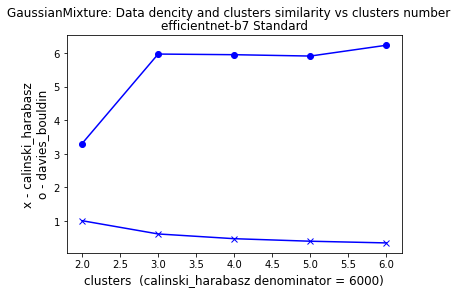

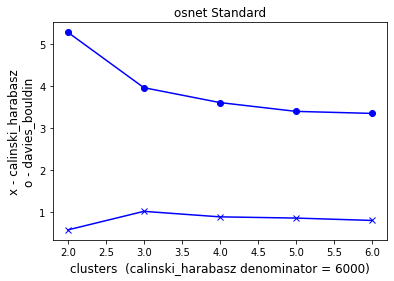

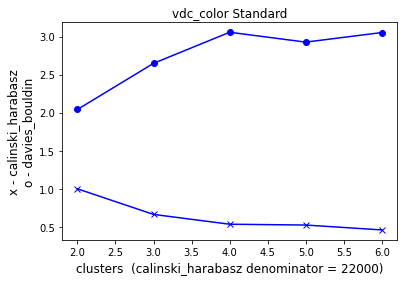

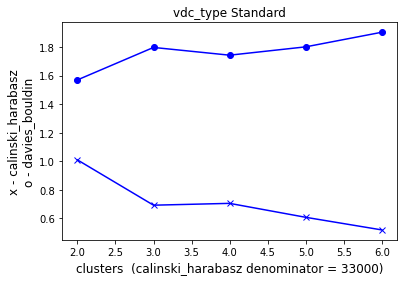

In [113]:
plt.suptitle('GaussianMixture: Data dencity and clusters similarity vs clusters number')
for i in range(n_models):
    plot_n_clust_choice(data, 'GaussianMixture_base', 'Standard', i)

For `GaussianMixture` first two descriptors show the same low quality.

Quality indexes of the last two descriptors are not so bad but worse than indexes received with `KMeans models` trained on the same data.

*

`MEAN SHIFT model` doesn't need number of clusters as parameter so other function `get_trained_model_data` is used to show actual number of clusters model revealed.

As we can see below `MeanShift model` doesn't find any cluster blobs on data structure of descriptors given but defines 75% of samples and more as outliers. 

In [191]:
def get_trained_model_data(X, model, params):
    '''
    Train model with params on data X.
    Avoid abrupt error stops at learning process.
    Return dictionary with labels, CHI, DBI, arrays of clusters labels and population. 
    '''
    result = {}
    print(f"descriptor  {data['descriptor_name'][i]}")
    try:
        X_pred = model(**params).fit_predict(X)
    except Exception as e:
        print(e)
        result['cluster'] = None
        result['chi'] = None
        result['dbi'] = None
        result['clust_indexes'] = None
        result['clust_sizes'] = None            
    else:
        result['cluster'] = X_pred
        result['chi'] = metrics.calinski_harabasz_score(X, X_pred)
        result['dbi'] = metrics.davies_bouldin_score(X, X_pred)
        clust_indexes, clust_sizes = np.unique(X_pred, return_counts=True)
        result['clust_indexes'] = clust_indexes
        result['clust_sizes'] = clust_sizes
        print(f"    number of clusters  {clust_indexes.shape[0]}")
        print(f"    calinski_harabasz   {result['chi']:.2f}")
        print(f"    davies_bouldin      {result['dbi']:.2f}")
        print(f"    objects in clusters {tuple(clust_sizes)}")
    return result


data['MeanShift_base'] = {'MinMax': {}, 'Robust': {}, 'Standard': {}}
params = {'bin_seeding': True, 'min_bin_freq': 50, 'cluster_all': False}
for i in data['pca']['Standard']:
    data['MeanShift_base']['Standard'][i] = get_trained_model_data(data['pca']['Standard'][i], cluster.MeanShift, params)

descriptor  efficientnet-b7
    number of clusters  2
    calinski_harabasz   3870.58
    davies_bouldin      2.17
    objects in clusters (3958, 96042)
descriptor  osnet
    number of clusters  2
    calinski_harabasz   3592.45
    davies_bouldin      3.70
    objects in clusters (9920, 90080)
descriptor  vdc_color
    number of clusters  2
    calinski_harabasz   8620.81
    davies_bouldin      2.70
    objects in clusters (14416, 85584)
descriptor  vdc_type
    number of clusters  2
    calinski_harabasz   13219.25
    davies_bouldin      2.56
    objects in clusters (25910, 74090)


At this stage `AgglomerativeClustering`, `AffinityPropagation`, `SpectralClustering` models were tried.

In [190]:
data['AffinityPropagation_base'] = {'MinMax': {}, 'Robust': {}, 'Standard': {}}
params = {'random_state': 32}
for i in data['pca']['Standard']:
    data['AffinityPropagation_base']['Standard'][i] = get_trained_model_data(data['pca']['Standard'][i], cluster.AffinityPropagation, params)

descriptor  efficientnet-b7
Unable to allocate 37.3 GiB for an array with shape (100000, 100000) and data type float32
descriptor  osnet
Unable to allocate 37.3 GiB for an array with shape (100000, 100000) and data type float32
descriptor  vdc_color
Unable to allocate 37.3 GiB for an array with shape (100000, 100000) and data type float32
descriptor  vdc_type
Unable to allocate 37.3 GiB for an array with shape (100000, 100000) and data type float32


Models like `AgglomerativeClustering`, `AffinityPropagation`, `SpectralClustering` doesn't work on 100'000-samples objects and stop with the following memory error:

```
Unable to allocate 37.3 GiB for an array with shape (100000, 100000) and data type float32
```

`Scikit-learn documentation` says that to avoid this memory size problem we could structure our clustering algoritm with `connectivity matrix` that defines for each sample the neighboring samples following a given structure of the data. 

So we prepare connectivity matrix with the help of `neighbors.kneighbors_graph` and try to train `AgglomerativeClustering model` ones more.

In [195]:
data['knn_graph'] = {'MinMax': {}, 'Robust': {}, 'Standard': {}}
for i in data['pca']['Standard']:
    data['knn_graph']['Standard'][i] = neighbors.kneighbors_graph(data['pca']['Standard'][i], 30, mode='distance', include_self=False)

In [196]:
data['AgglomerativeClustering_base'] = {'MinMax': {}, 'Robust': {}, 'Standard': {}}
for i in data['pca']['Standard']:
    params = {'linkage': 'ward', 'connectivity': data['knn_graph']['Standard'][i]}
    data['AgglomerativeClustering_base']['Standard'][i] = scores_for_n_clust_choice(
        data['pca']['Standard'][i], cluster.AgglomerativeClustering, params, n_clust_range=[_ for _ in range(2, 7)])

descriptor  efficientnet-b7, n clusters = 2
    calinski_harabasz  5734.42795754677
    davies_bouldin     3.191198569398252
descriptor  efficientnet-b7, n clusters = 3
    calinski_harabasz  3362.429875899084
    davies_bouldin     7.253743051357531
descriptor  efficientnet-b7, n clusters = 4
    calinski_harabasz  2549.3417443799867
    davies_bouldin     6.704335220471784
descriptor  efficientnet-b7, n clusters = 5
    calinski_harabasz  2073.610359784122
    davies_bouldin     6.6351694985700576
descriptor  efficientnet-b7, n clusters = 6
    calinski_harabasz  1755.6424265236776
    davies_bouldin     7.431025893325857
descriptor  osnet, n clusters = 2
    calinski_harabasz  6330.094083428846
    davies_bouldin     3.216156376969221
descriptor  osnet, n clusters = 3
    calinski_harabasz  5119.765775783542
    davies_bouldin     3.8365333559674646
descriptor  osnet, n clusters = 4
    calinski_harabasz  4638.396985835456
    davies_bouldin     3.6092892831429904
descriptor  osnet,

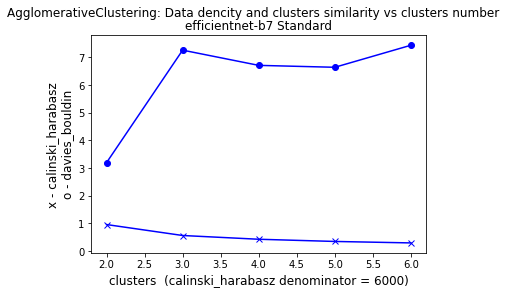

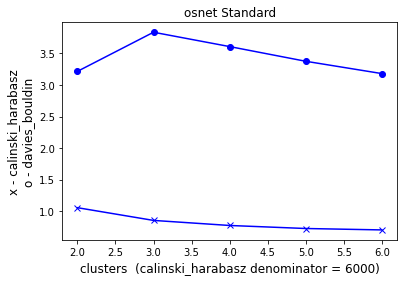

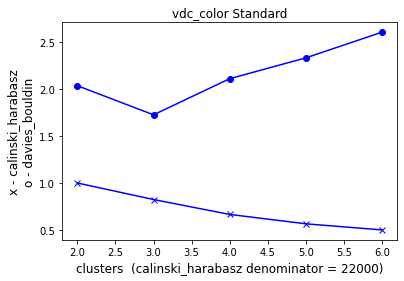

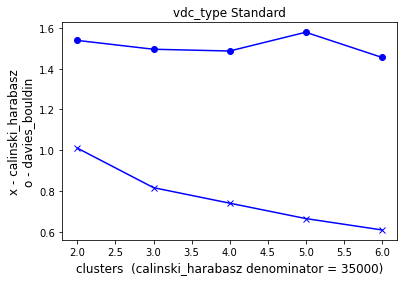

In [197]:
plt.suptitle('AgglomerativeClustering: Data dencity and clusters similarity vs clusters number')
for i in range(n_models):
    plot_n_clust_choice(data, 'AgglomerativeClustering_base', 'Standard', i)

As before there is no interesting results for the first two descriptors and quality indexes for the last two descriptors are a bit worse then for `KMeans models`.

*

Let's consider some random car images from the clusters defined by models on descriptors with the best scores.

In [215]:
def plot_samples_images(data, cluster_label, nrows=4, ncols=4, figsize=(16, 8)):
    '''
    Read from zip-archive and visualise some random images from the cluster cluster_label.
    Paths to images and clusters labels should be DataFrame with columns "paths" и "cluster".

    Args:
        data (DataFrame): DataFrame with paths to images and clusters labels
        cluster_label (int): cluster label
        nrows (int, optional): number of rows with images (default=4)
        ncols (int, optional): number of columns with images (default=4)
        figsize (tuple, optional): size of figer with images (default=(16, 8))
    '''
    samples_indexes = np.array(data[data['cluster'] == cluster_label].index)
    np.random.shuffle(samples_indexes)
    paths = data.loc[samples_indexes, 'paths']


    fig, axes = plt.subplots(nrows,ncols)
    fig.set_size_inches(*figsize)
    fig.suptitle(f"Images from cluster {cluster_label}", fontsize=16)
    with ZipFile('data/archive.zip') as myzip:
        for i in range(nrows):
            for j in range(ncols):
                # set index of the image path
                path_idx = i * ncols + j
                if path_idx >= len(paths):
                    break
                path = 'IntelliVision_case/raw_data/' + paths.iloc[path_idx].replace('\\', '/')
                img = plt.imread(myzip.open(path))
                axes[i,j].imshow(img)
                axes[i,j].axis('off')

`KMeans` model trained on `vdc_type` descriptor with `number of clusters` = 6 displays one of the highest `CHI` 25 117 and the best `DBI` 1.40.

6 clusters (below) could be interpreted as:

0. crossovers, wagons, jeeps and A-class
1. cars
2. intermediate between 0 and 1 where 0 prevails
3. buses and vans
4. trucks
5. cars backview

At this small sampling we can count True / False images as 16/0 , 16/0 , 16/0 , 12/4 , 16/0 , 15/1 and estimate percent of successful clusterization as 94%. Of course to make statistically significant estimation we need to repeat this counting much more times.  

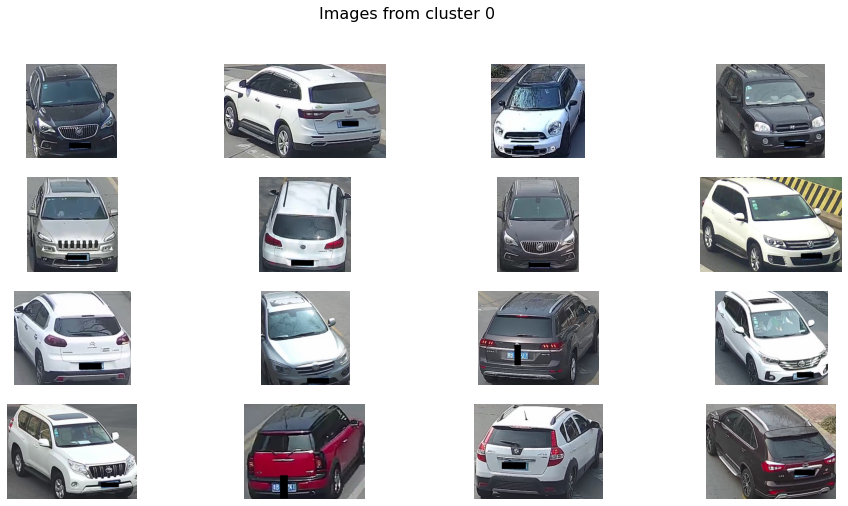

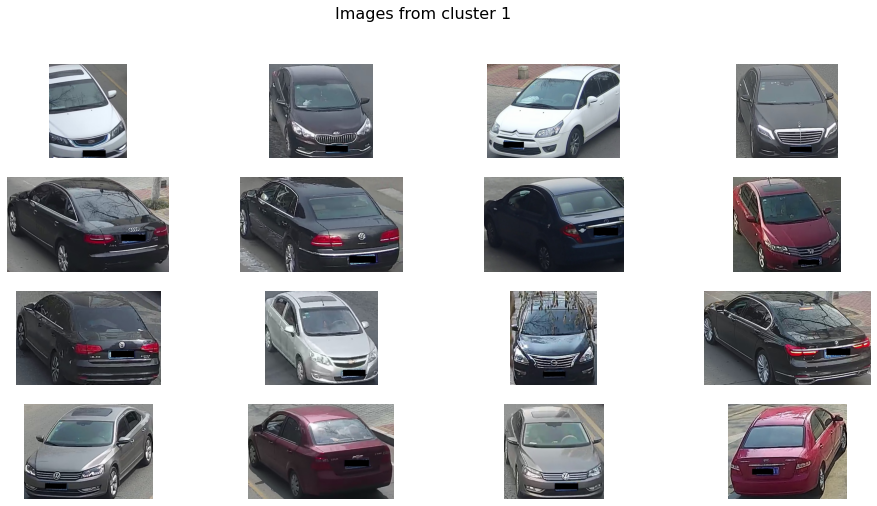

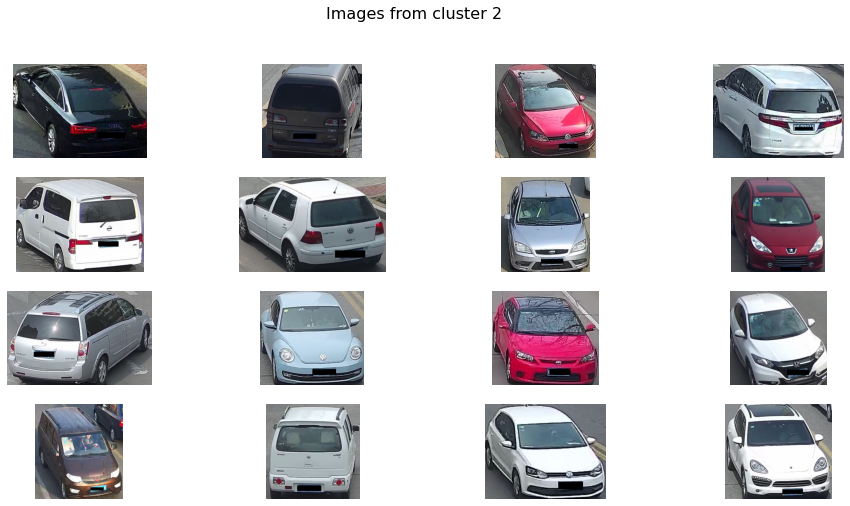

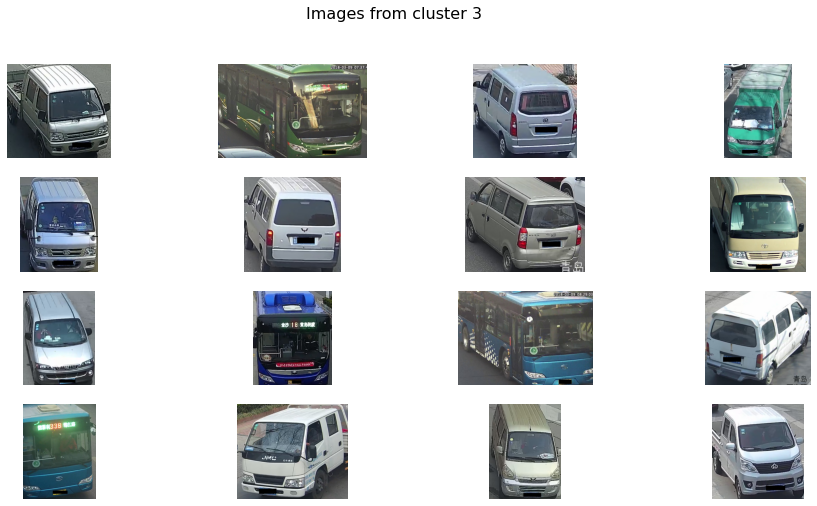

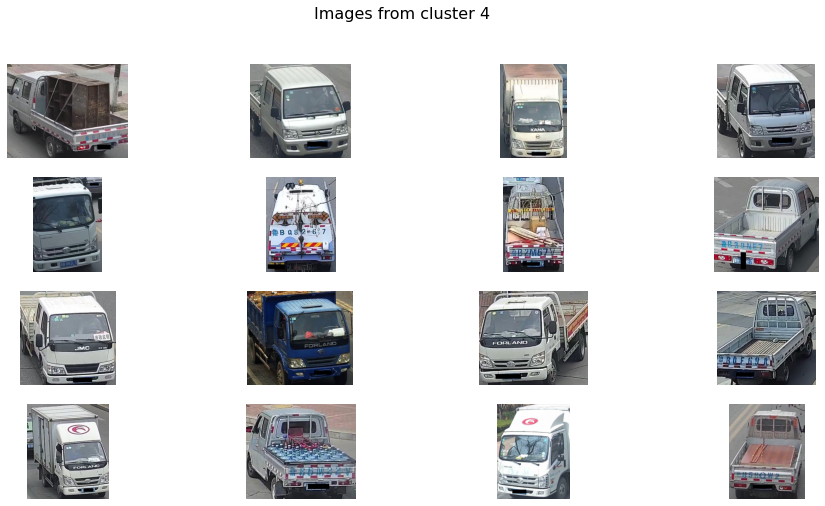

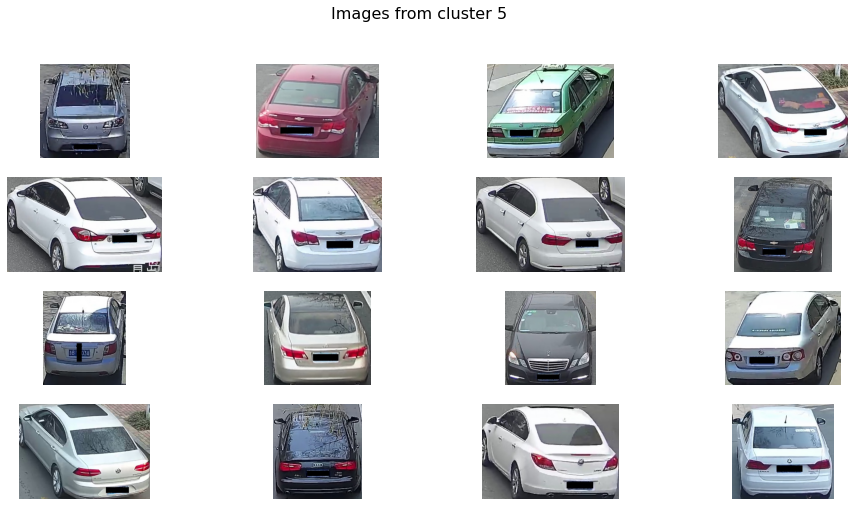

In [216]:
df = images_paths.copy()
df['cluster'] = data['KMeans_base']['Standard'][3][6]['cluster']
for lb in range(6):
    plot_samples_images(data=df, cluster_label=lb)

`GaussianMixture` model trained on `vdc_type` descriptor displays its the best scores with `number of clusters` = 4: `CHI` 23 279 and `DBI` 1.74.

4 clusters (below) could be interpreted as:

0. cars backview
1. crossovers, wagons and jeeps
2. cars frontview
3. trucks, buses, vans and A-class

Here counting True / False images 15/1 , 16/0 , 14/2 , 13/3 gives 90% successful clusterization. But interpretation of clusters is not just consolidation of six clusters of the model above. Clusterization is a bit different. 

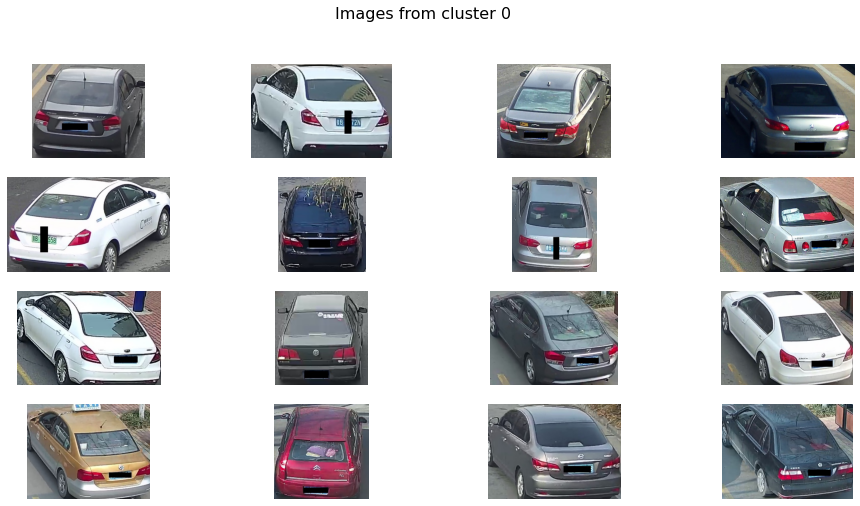

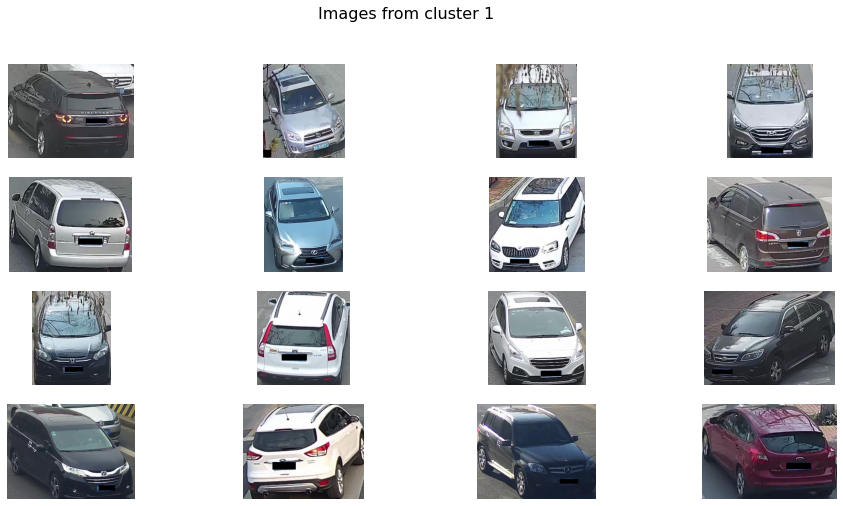

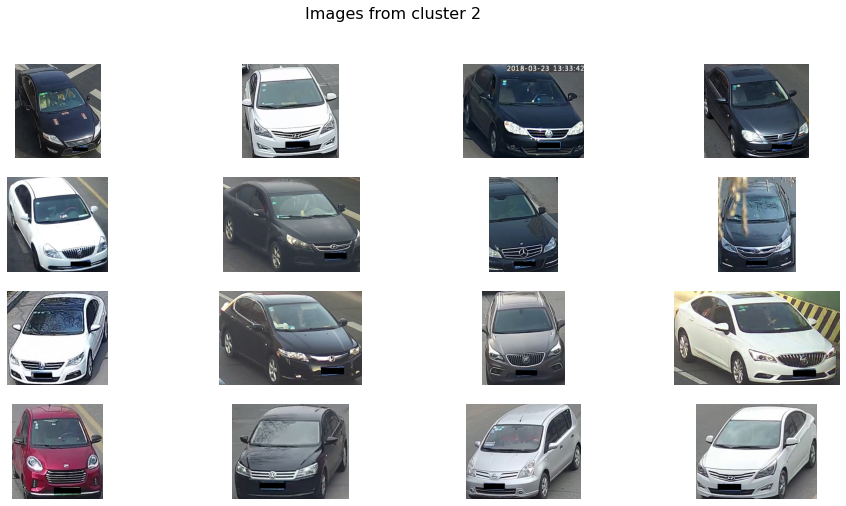

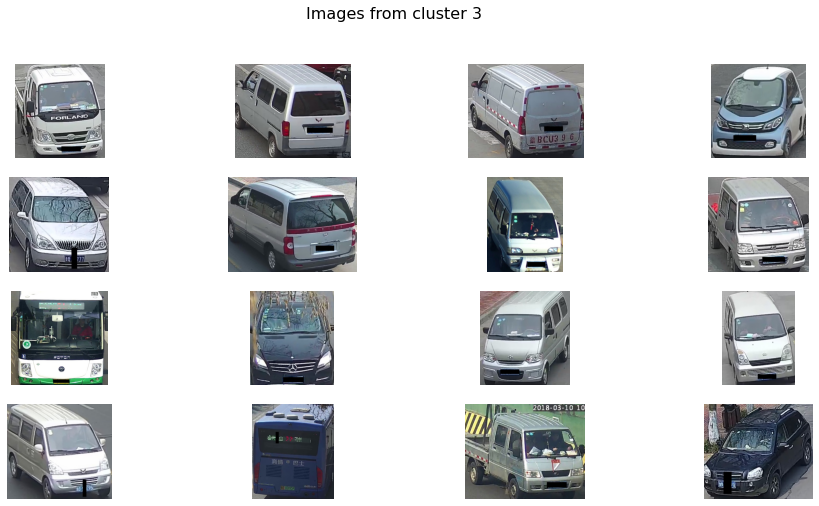

In [217]:
df = images_paths.copy()
df['cluster'] = data['GaussianMixture_base']['Standard'][3][4]['cluster']
for lb in range(4):
    plot_samples_images(data=df, cluster_label=lb)

`AgglomerativeClustering` model trained on `vdc_type` descriptor displays close scores with `number of clusters` = 4: `CHI` 25 321 and `DBI` 1.49 and `number of clusters` = 6: `CHI` 21 328 and `DBI` 1.46. But added two more clusters turn out to be mixtures of four base classes and don't bring any new information.

So we take 4 clusters below and interpret them as following:

0. crossovers, wagons and jeeps
1. trucks, buses, vans
2. cars frontview
3. cars backview

Counting True / False images 14/2 , 16/0 , 15/1 , 16/0 gives 95% successful clusterization.

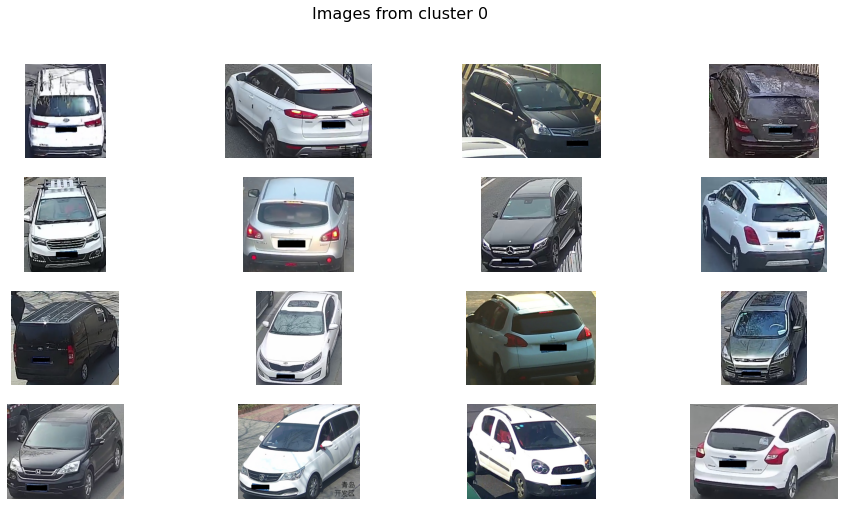

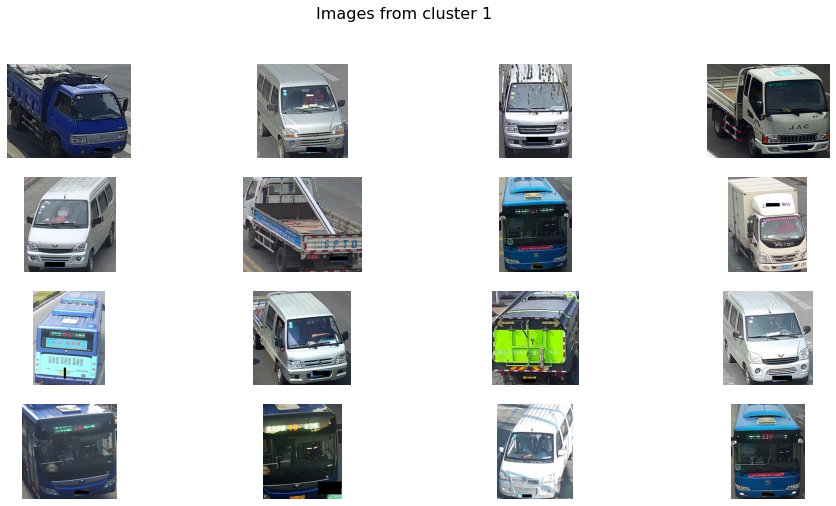

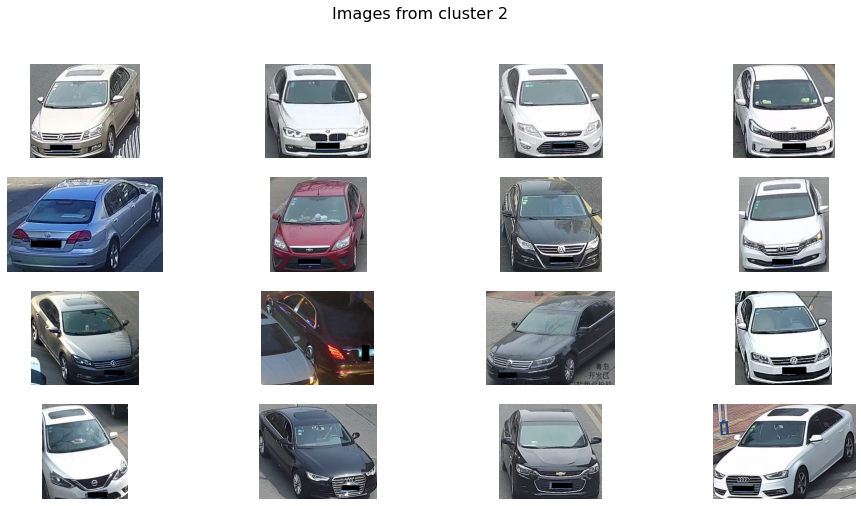

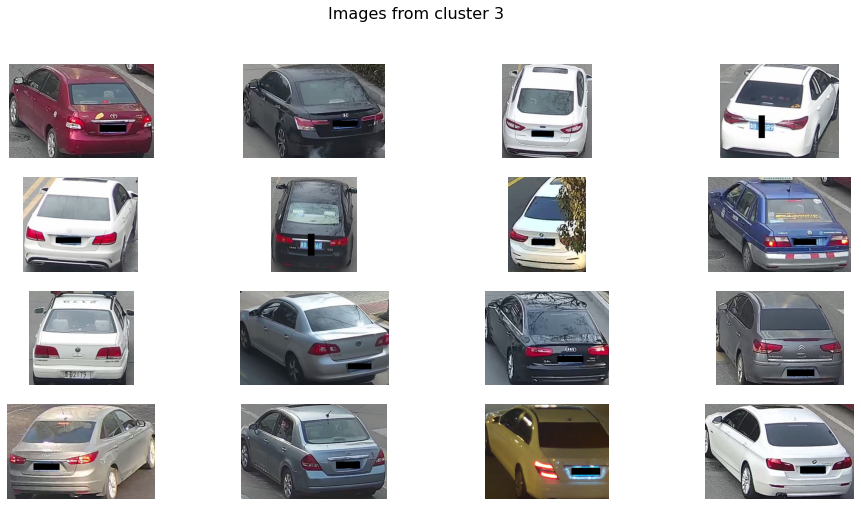

In [222]:
df = images_paths.copy()
df['cluster'] = data['AgglomerativeClustering_base']['Standard'][3][4]['cluster']
for lb in range(4):
    plot_samples_images(data=df, cluster_label=lb)

Now let's consider `KMeans` model trained on `vdc_color` descriptor. This descriptor shows the best scores with `number of clusters` = 3 and divides all vehicles by red, white+ and all other colors. But with `number of clusters` = 6, `CHI` 13 051 instead of 19 606 and `DBI` 2.28 instead of 1.66 we still got additional information:

0. black
1. dark
2. white
3. red
4. light
5. blue, green, etc

Counting True / False images 10/6 , 7/9 , 13/3 , 16/0 , 8/8 , 8/8 gives 64% successful clusterization. It is not so bad considering "all shades of grey" that cause confusion.

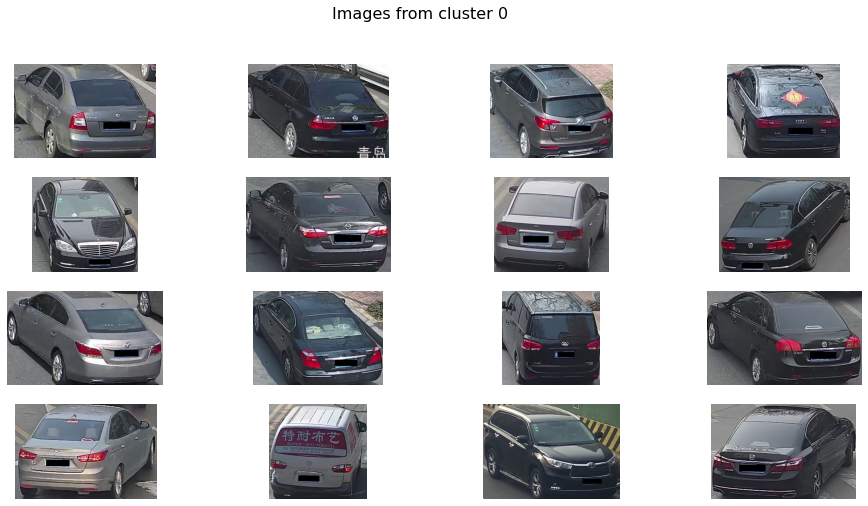

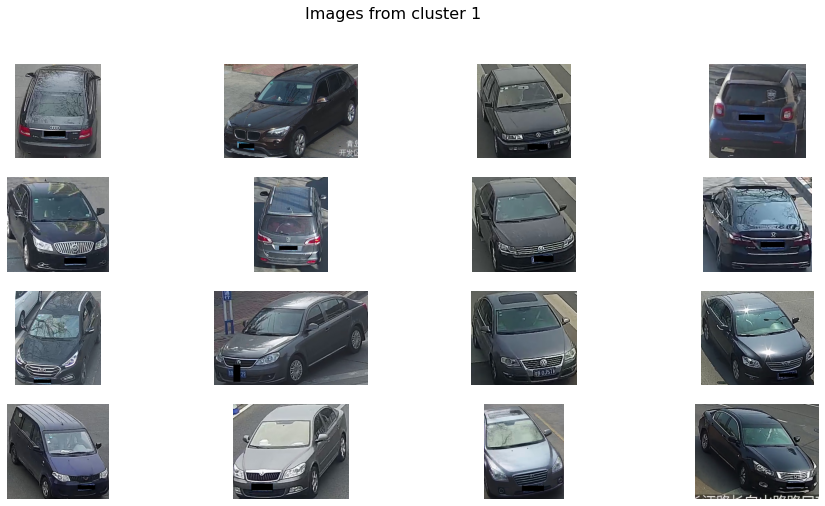

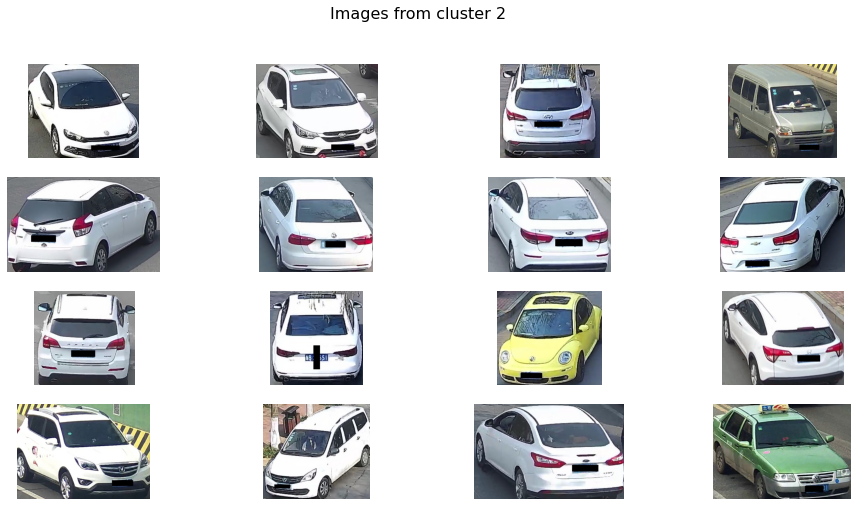

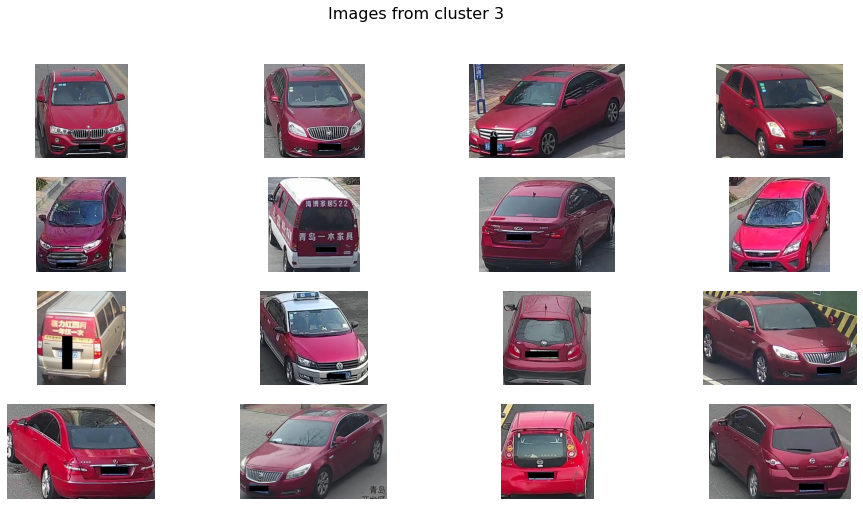

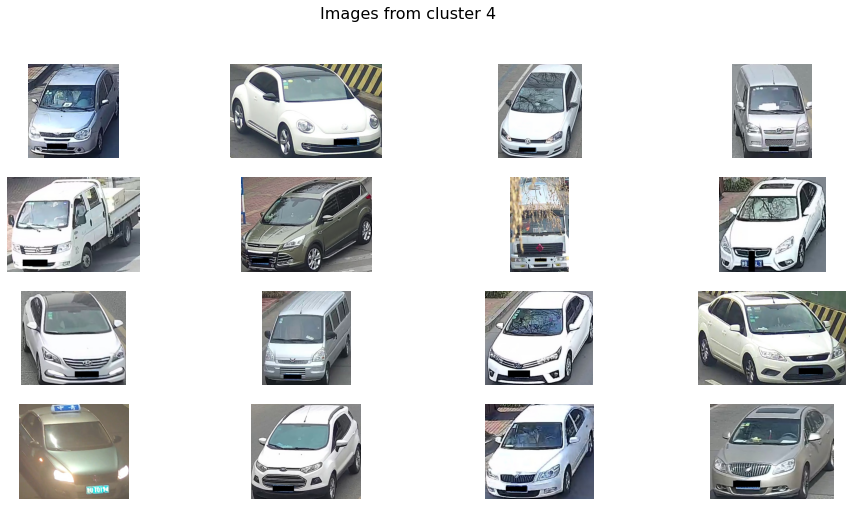

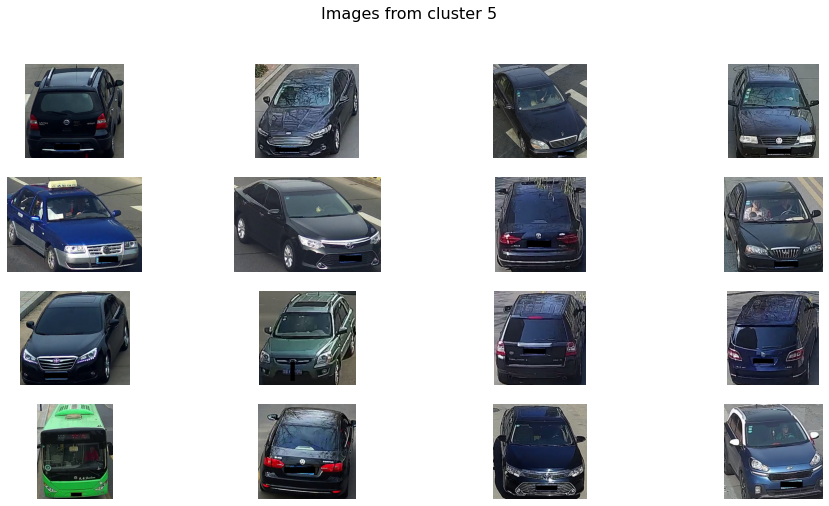

In [226]:
df = images_paths.copy()
df['cluster'] = data['KMeans_base']['Standard'][2][6]['cluster']   # KMeans   GaussianMixture   AgglomerativeClustering
for lb in range(6):
    plot_samples_images(data=df, cluster_label=lb)

`GaussianMixture` model trained on `osnet` descriptor divides vehicles by colored, white and dark.

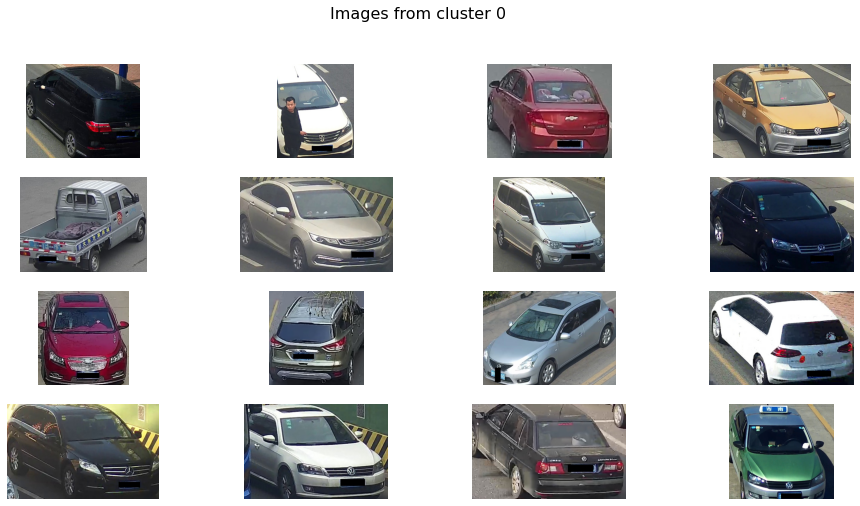

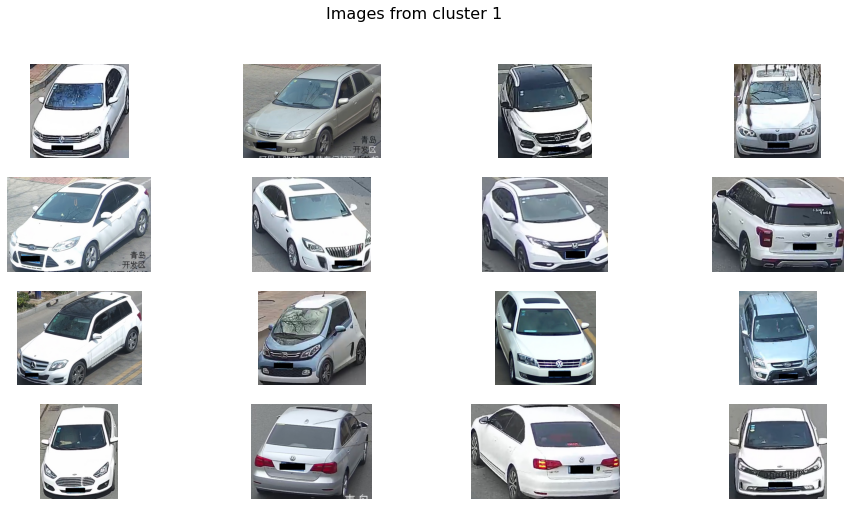

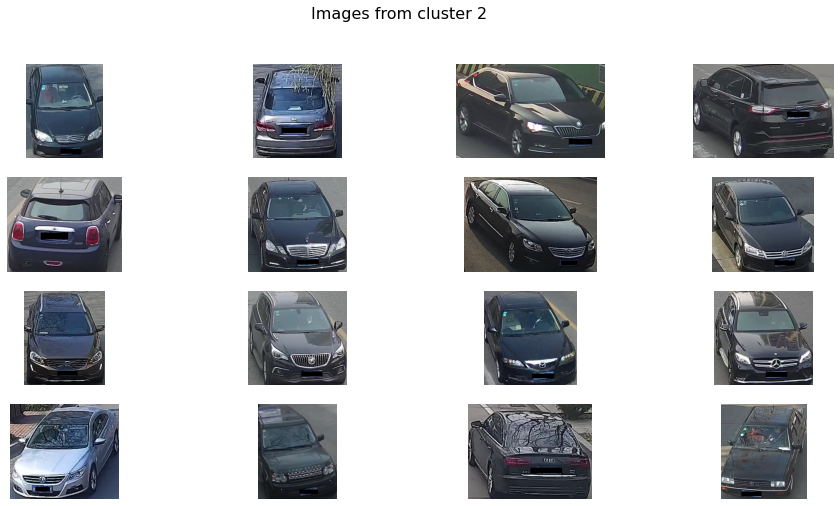

In [228]:
df = images_paths.copy()
df['cluster'] = data['GaussianMixture_base']['Standard'][1][3]['cluster']   # KMeans   GaussianMixture   AgglomerativeClustering
for lb in range(3):
    plot_samples_images(data=df, cluster_label=lb)

Now let's transform features got from `vdc_type` descriptor for 2D visualisation with `t-SNE` method.

In [143]:
t_sne = manifold.TSNE(n_components=2)
X_2d = t_sne.fit_transform(data['pca']['Standard'][3])

Consider `KMeans` model trained on `vdc_type` descriptor with `number of clusters` = 6, 5 and 4.

We interpreted 2nd of six clusters as mixture of zero and 1st. The purple cluster takes intermediate position between orange and green.

Unfortunately reduction by one class doesn't exclude this confusing cluster but makes it larger. Instead we loose division of trucks and buses. By the way, we could predict this lost of information because of scores decrease for `number of clusters` = 5.

And only reduction to 4 clusters gives division of cars and crossovers without this intermediate cluster.

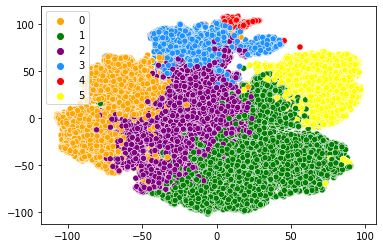

In [211]:
sns.scatterplot(x=X_2d[:,0], y=X_2d[:,1], hue=data['KMeans_base']['Standard'][3][6]['cluster'], 
                palette=['orange', 'green', 'purple', 'dodgerblue', 'red', 'yellow'], legend='full');

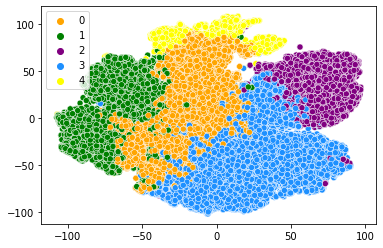

In [212]:
sns.scatterplot(x=X_2d[:,0], y=X_2d[:,1], hue=data['KMeans_base']['Standard'][3][5]['cluster'], 
                palette=['orange', 'green', 'purple', 'dodgerblue', 'yellow'], legend='full');

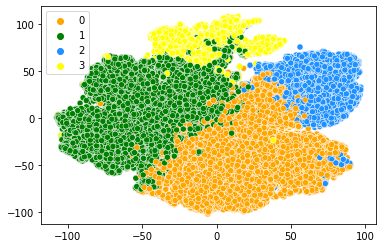

In [209]:
sns.scatterplot(x=X_2d[:,0], y=X_2d[:,1], hue=data['KMeans_base']['Standard'][3][4]['cluster'], 
                palette=['orange', 'green', 'dodgerblue', 'yellow'], legend='full');

And if display `GaussianMixture` model trained on `vdc_type` descriptor we can explain why `KMeans` model has no clean `cars frontview` class: two right clucters that correspond cars backview (upper) and frontview (lower) has different division lines defined by two models.

At this part `GaussianMixture` works better.

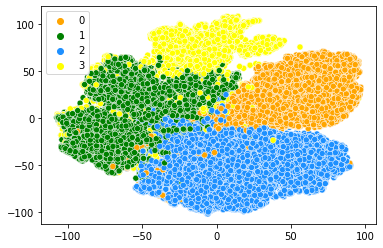

In [161]:
sns.scatterplot(x=X_2d[:,0], y=X_2d[:,1], hue=data['GaussianMixture_base']['Standard'][3][4]['cluster'], 
                palette=['orange', 'green', 'dodgerblue', 'yellow'], legend='full');

2D-plotting of clusterization on the base of `vdc_color` descriptor confirms our conclusions above. Clusters boundaries are not so clear. Black, blue and dark clusters poorly divided. The same can be said about light and white clusters. Our express True / False estimation showed the same result.

In [141]:
t_sne_vdc_color = manifold.TSNE(n_components=2)
X_2d_vdc_color = t_sne_vdc_color.fit_transform(data['pca']['Standard'][2])

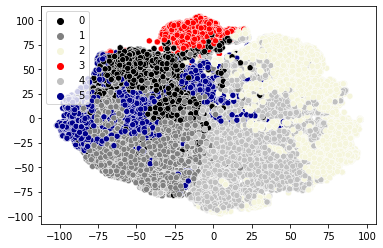

In [166]:
sns.scatterplot(x=X_2d_vdc_color[:,0], y=X_2d_vdc_color[:,1], hue=data['KMeans_base']['Standard'][2][6]['cluster'], 
                palette=['black', 'gray', 'beige', 'red', 'silver', 'darkblue'], legend='full');

Additionally we can plot 3D-model to consider сluster separation from different angles. It allows to compare how different models labeled the same areas of increased density. And clearness of separating surfaces.

In [146]:
t_sne_3d = manifold.TSNE(n_components=3)
X_3d = t_sne_3d.fit_transform(data['pca']['Standard'][3])

In [332]:
fig = px.scatter_3d(x=X_3d[:,0], y=X_3d[:,1], z=X_3d[:,2], color=data['KMeans_base']['Standard'][3][6]['cluster'], width=1000, height=700)
fig.update_traces(marker_size = 1)
fig.show();

In [333]:
fig = px.scatter_3d(x=X_3d[:,0], y=X_3d[:,1], z=X_3d[:,2], color=data['GaussianMixture_base']['Standard'][3][4]['cluster'], width=1000, height=700)
fig.update_traces(marker_size = 1)
fig.show();

The same 3D-plot by means of `matplotlib.pyplot`. For the case if `pyplot` woudn't work at GitHub.

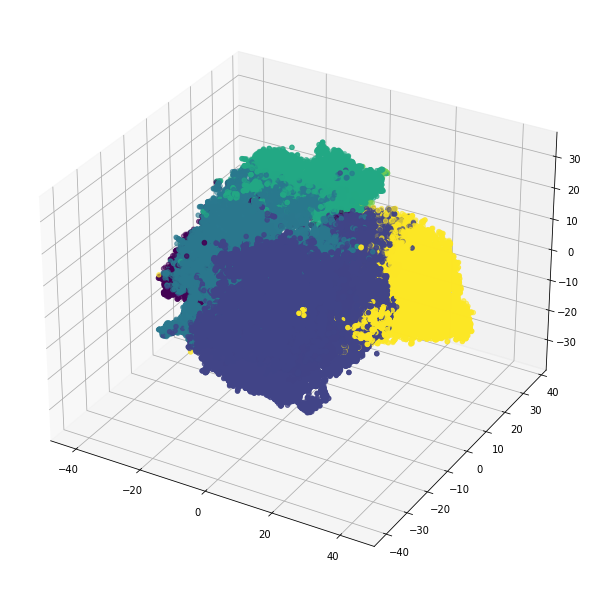

In [169]:
def scatter_3d(x, y, z, c):
    # create 3d-figure object by adding ax to 2d-figure
    fig = plt.figure(figsize=(8,8))
    ax = Axes3D(fig)
    fig.add_axes(ax)
    ax.scatter(x, y, z, c=c)
    
scatter_3d(x=X_3d[:,0], y=X_3d[:,1], z=X_3d[:,2], c=data['KMeans_base']['Standard'][3][6]['cluster'])

Now let's try to discriminate outlier samples. 

`cluster.OPTICS` with `cluster_method='dbscan'` is used instead of `DBSCAN` because it works better with memory at data with a lot of samples.

Prepared `vdc_type` descriptor was taken as the base of good working clusterization model.

Some values of eps parameter were considered to get dynamics of outliers number. We start with `eps` = 10 that gives 1 686 potential outliers, end with `eps` = 16 and 96 potential outliers.

In [ ]:
optics_base = {}
max_eps = 10
while True:
    try:
        optics_base[max_eps] = {}
        opt = cluster.OPTICS(min_samples=5, max_eps=max_eps, metric='minkowski', p=2, cluster_method='dbscan').fit(data['pca']['Standard'][3])
        optics_base[max_eps]['cluster'] = opt.labels_
        clust_opt, size_opt = np.unique(opt.labels_, return_counts=True)
        print(f"eps = {max_eps}, n_clusters = {clust_opt.shape[0]}, zero cluster {clust_opt[0]} with population {size_opt[0]}")
    except Exception as e:
        print(f"eps = {max_eps} error:", e)
        break
    if clust_opt.shape[0] < 2 or (clust_opt[0] == -1 and size_opt[0] < 100) or clust_opt[0] != -1 or max_eps > 15:
        break
    max_eps += 1    

Outliers are labeled as following: 

- the last 96 samples which rests as outliers even with `eps` = 16 get the label `1` 
- the first samples which are absorbed by main clusters with `eps` shifted from 10 to 11 get the label `7`

In [299]:
outliers = np.where(optics_base[16]['cluster'] == -1, 1, 0)
for eps in range(15, 9, -1):
    outliers = np.where((optics_base[eps]['cluster'] == -1) & (outliers == 0), 17 - eps, outliers)

np.where(outliers != 0)[0].shape

(1686,)

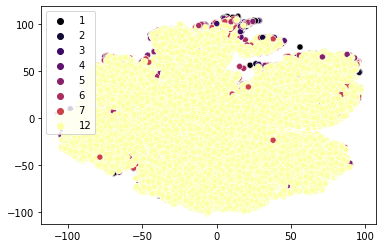

In [317]:
outliers_show = np.where(outliers == 0, 12, outliers)
sns.scatterplot(x=X_2d[:,0], y=X_2d[:,1], hue=outliers_show, palette='inferno', legend='full');  # plt.get_cmap('CMRmap').reversed()

Both 2D and 3D-visualization reveal that outliers tend to the boundaries of the main body mostly near the areas of trucks, buses and crossovers.

In [310]:
fig = px.scatter_3d(x=X_3d[:,0], y=X_3d[:,1], z=X_3d[:,2], color=outliers_show, width=1000, height=700)
fig.update_traces(marker_size = 1)
fig.show();

The random images from 3 groups of the mostly far outliers confirm our suppose:

there are images of trucks, buses and some crossovers that our model clusterise good enough. We needn't discriminate these images as outliers.

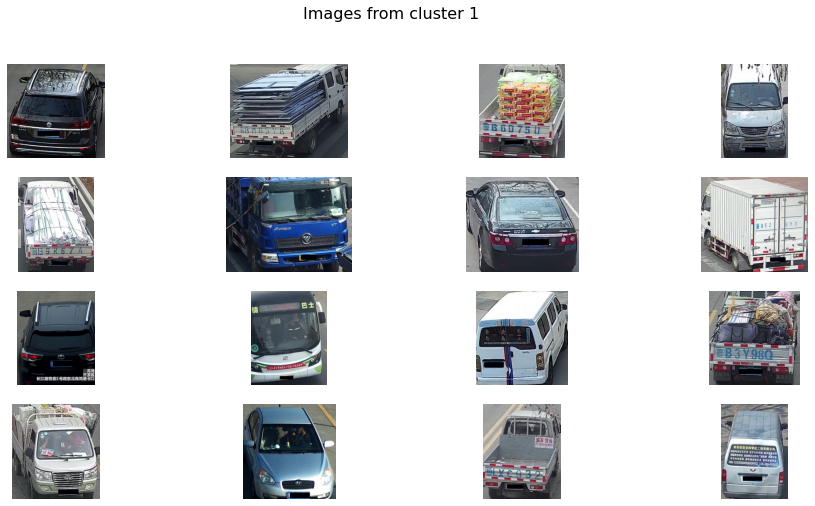

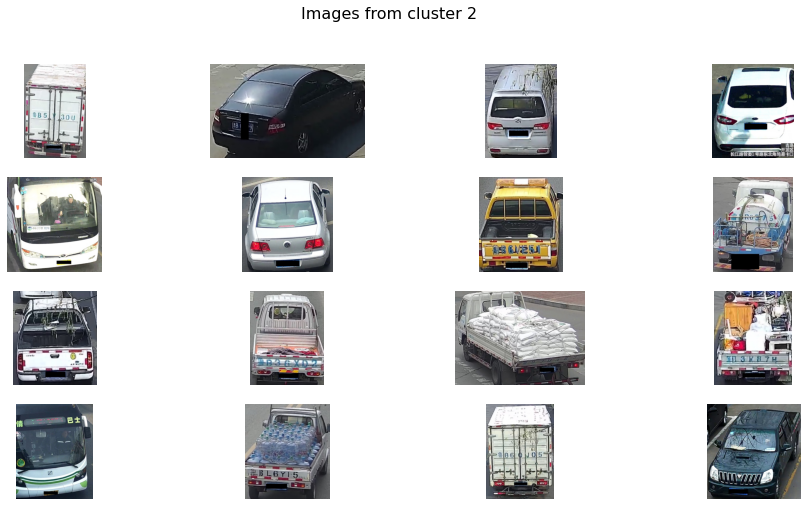

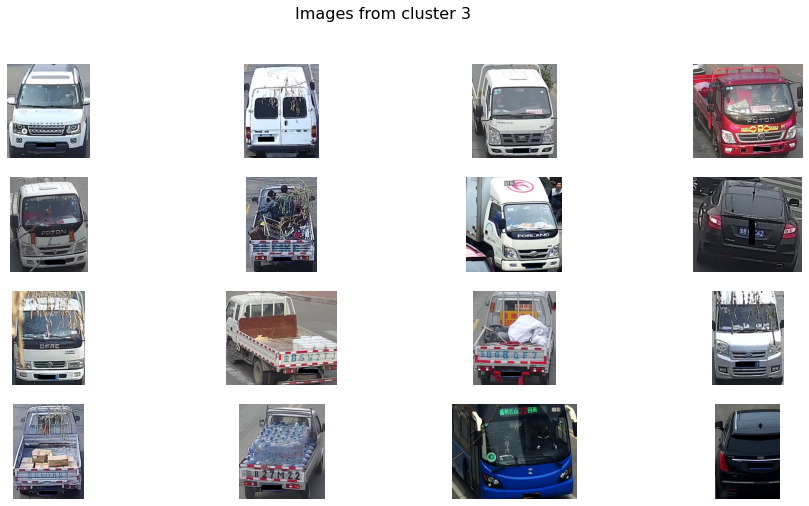

In [319]:
df = images_paths.copy()
df['cluster'] = outliers
for lb in range(1, 4):
    plot_samples_images(data=df, cluster_label=lb)

For another attempt to figure out outliers let's take `osnet` descriptor (in hope that it can underline objects that are no cars). That one prepared with `RobustScaler` that works better with outliers. Repeat all steps at suitable range of `eps` values.

In [325]:
optics_base_robust = {}
max_eps = 50
while True:
    try:
        optics_base_robust[max_eps] = {}
        opt = cluster.OPTICS(min_samples=5, max_eps=max_eps, metric='minkowski', p=2, cluster_method='dbscan').fit(data['pca']['Robust'][1])
        optics_base_robust[max_eps]['cluster'] = opt.labels_
        clust_opt, size_opt = np.unique(opt.labels_, return_counts=True)
        print(f"eps = {max_eps}, n_clusters = {clust_opt.shape[0]}, zero cluster {clust_opt[0]} with population {size_opt[0]}")
    except Exception as e:
        print(f"eps = {max_eps} error:", e)
        break
    if clust_opt.shape[0] < 2 or (clust_opt[0] == -1 and size_opt[0] < 100) or clust_opt[0] != -1 or max_eps > 100:
        break
    max_eps += 5

eps = 50, n_clusters = 11, zero cluster -1 with population 628
eps = 55, n_clusters = 10, zero cluster -1 with population 485
eps = 60, n_clusters = 7, zero cluster -1 with population 374
eps = 65, n_clusters = 3, zero cluster -1 with population 294
eps = 70, n_clusters = 3, zero cluster -1 with population 244
eps = 75, n_clusters = 2, zero cluster -1 with population 180
eps = 80, n_clusters = 2, zero cluster -1 with population 133
eps = 85, n_clusters = 3, zero cluster -1 with population 97


In [328]:
outliers_robust = np.where(optics_base_robust[85]['cluster'] == -1, 1, 0)
for eps in range(80, 49, -5):
    outliers_robust = np.where((optics_base_robust[eps]['cluster'] == -1) & (outliers_robust == 0), 18 - eps/5, outliers_robust)

np.where(outliers_robust != 0)[0].shape

(628,)

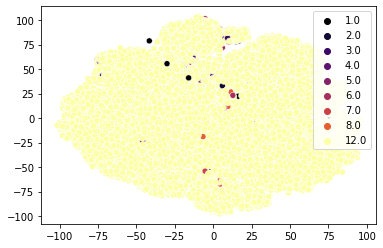

In [339]:
outliers_robust_show = np.where(outliers_robust == 0, 12, outliers_robust)
sns.scatterplot(x=X_2d_vdc_color[:,0], y=X_2d_vdc_color[:,1], hue=outliers_robust_show, palette='inferno', legend='full');

This descriptor marks as outliers objects of surtain colors. We can see it at the random images below. And at 2D-plot of `vdc_color` descriptor marked samples tends to inner boundary lines between color clusters.

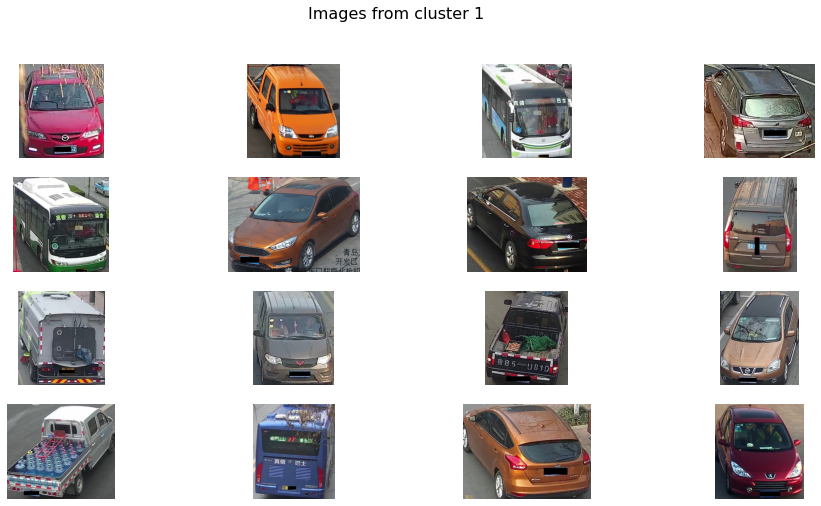

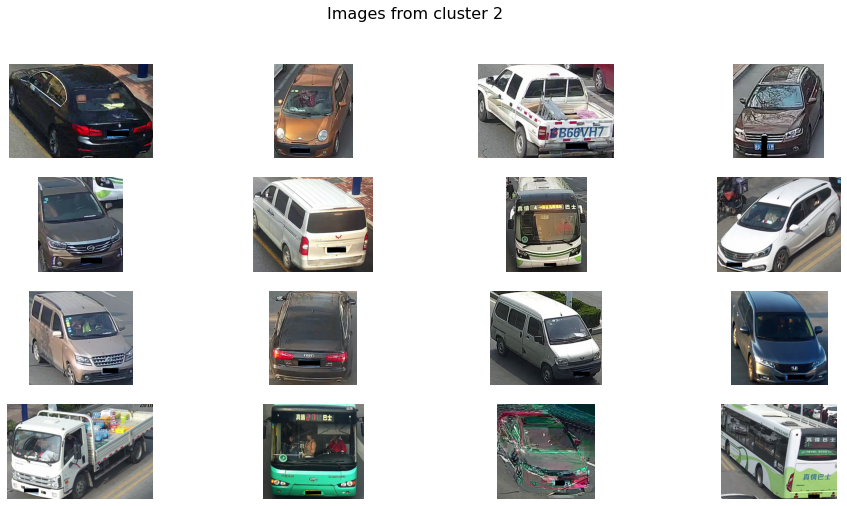

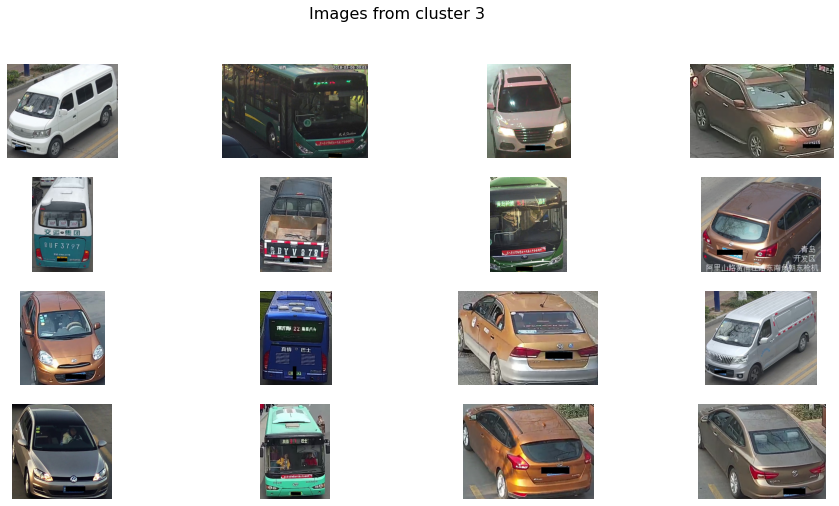

In [331]:
df = images_paths.copy()
df['cluster'] = outliers_robust
for lb in range(1, 4):
    plot_samples_images(data=df, cluster_label=lb)

Unfortunately at this point I should stop my research. Otherwise GitHub won't accept my giant notebook.

In [235]:
pd.to_pickle(data, 'data/data.pickle')